<div class="alert alert-block alert-info" >
    <h1>Robot Perception</h1>
    <h3>General Information:</h3>
    <p>Please do not add or delete any cells. Answers belong into the corresponding cells (below the question). If a function is given (either as a signature or a full function), you should not change the name, arguments or return value of the function.<br><br> If you encounter empty cells underneath the answer that can not be edited, please ignore them, they are for testing purposes.<br><br>When editing an assignment there can be the case that there are variables in the kernel. To make sure your assignment works, please restart the kernel and run all cells before submitting (e.g. via <i>Kernel -> Restart & Run All</i>).</p>
    <p>Code cells where you are supposed to give your answer often include the line  ```raise NotImplementedError```. This makes it easier to automatically grade answers. If you edit the cell please outcomment or delete this line. </p>
    <br>The server resource is limited to 2 core cpu and 1GB RAM at max per user. If you use more than that, the kernel may die. Nevertheless, you can bring it up again by restaring the kernel (Kernel -> Restart and clear output).<br>
    <h3>Submission:</h3>
    <p>Upload all attachments required to run the notebook and provide a correct path to them.</p>
    <p><strike>Please submit your notebook via the web interface (in the main view -> Assignments -> Submit)</strike>.</p> 
    <p>Starting from RP-HW07 onwards, submit the notebook and pdf version of it via LEA.</p>
    <p>The assignments are due on <b>Monday at 0:00.</b> (i.e. Sunday 23:59 + 1 min)</p>
    <h3>Group Work:</h3>
    <p>You are allowed to work in groups of up to two people. Please enter the UID (your username here) of each member of the group into the next cell. We apply plagiarism checking, so do not submit solutions from other people except your team members. If an assignment has a copied solution, the task will be graded with 0 points for all people with the same solution.</p>
    <p><b>YOU SHOULD ONLY SUBMIT EXACTLY ONE PER GROUP</b></p>
    <h3>Questions about the Assignment:</h3>
    <p>If you have questions about the assignment please post them in the LEA forum before the deadline. Don't wait until the last day to post questions.</p></div>

<div class="alert alert-block alert-danger">
<p><b>Put your answer in the PROVIDED CELLS only!</b></p>
<b>Any new cell is not visible during the grading.</b>
<p>We provide additional code and markdown cells for each question, so that you do not have to add the new ones.</p>
<p>Do not copy the metadata from one cell to another as it is unique to that cell only.</p></div>

In [1]:
'''
Group Work:
Enter the UID (i.e. student2s) of each team member into the variables. 
If you work alone please leave the second variable empty, or extend this list if necessary.
'''
member1 = 'dpadma2s'
member2 = 'jbandl2s'
member3 = 'smuthi2s'

## Q&As: Pose three questions (and ans.) to last lecture, 3 Q&As per member [1 point]

The format of the question and answer should be [Q1,A1,Q2,A2,Q3,A3,...,Qn,An], where Q1 is the question and A1 is the answer.<br>
If you work in a group, the total of the Q&As is $3xn$, where $n$ is the total number of members.<br>

Put your answer in the provided cell below!<br>
If you work in a group, you can extend the provided Q&A template, but please use the same format:
1. Q and A are separated by ONE $<$br$>$
2. Q&A and other Q&As are separated by TWO $<$br$>$

Or copy the provided format in the answer cell, and change the Q&A number.
<br>
Do not remove any markdown tag like $<$br$>$ in the answer cell.

**New questions for last week's lecture**
<br>
Q1 = What is the objective of 2D rectification?
<br>
A1 = 

Image rectification, the process of resampling pairs of stereo images taken from widely differing viewpoints in order to produce a pair of “matched epipolar projections”. 

Given images J and J‘, return a resampled pair of images in which the epipolar lines are parallel to the x axis and matched, and the disparity between corresponding points in the resampled images is minimized.
<br>
<br>
Q2 = Give the 2D rectification algorithm.
<br>
A2 = 

Algorithm of 2D rectification:
1. Identify corresponding points $x_i$ <-> $x‘_i$.
2. Compute the fundamental matrix F and extract epipoles e,e' for left and right images, respectively.
3. Select Homography transformation, H' which maps epipole e' of right image to $(1,0,0)^T$.
4. Find Homography, H minimizing: $\sum_id(Hx, H'x'_i)^2$.
5. Resample J according to H and J' according to H'.
<br>
<br>

Q3 = What is point reconstruction problem? What is the workaround?
<br>
A3 = 

Due to image measurement errors, the backprojection of the corresponding points $x_i$ <-> $x'_i$ does not match and is skewed.  This means that there will not be a point X which exactly satisfies $x = PX$, $x' = P'X$ and the image will not satisfy the epipolar constraint $x^TFx =0$. The measured points do not satisfy the epipolar constraint. The epipolar line $l' = Fx$ is the image of the ray through x, and $l = F^Tx'$ is the image of the ray through x'. Since the rays do not intersect, x' does not lie on l' , and x does not lie on l. This is the point reconstruction problem.

A desirable feature of the method of triangulation used is that it should be invariant under transformations of the appropriate class for the reconstruction – if the camera matrices are known only up to an affine (or projective) transformation, then it is clearly desirable to use an affine (resp. projective) invariant triangulation method to compute the 3D space points.

Let the triangulation method be: $X = \boldsymbol{\tau}\left(\mathbf{x}, \mathbf{x}^{\prime}, \mathbf{P}, \mathbf{P}^{\prime}\right) $, the method should be invariant under projective transformation.

The triangulation is said to be invariant under a transformation H if
    
\begin{equation}
\boldsymbol{\tau}\left(\mathbf{x}, \mathbf{x}^{\prime}, \mathbf{P}, \mathbf{P}^{\prime}\right)=\mathbf{H}^{-1} \boldsymbol{\tau}\left(\mathbf{x}, \mathbf{x}^{\prime}, \mathbf{P} \mathbf{H}^{-1}, \mathbf{P}^{\prime} \mathbf{H}^{-1}\right)
\end{equation}

If we adopt this goal, minimizing error in $IP^3$ will not work because distance and perpendicularity relationships are not invariant in $IP^3$. Instead of $IP^3$ error minimization, a 3D point X satisfying $x = PX$ and $x' = PX$ is estimated followed by maximizing the likelihood of the measurements under Gaussian
error.
<br>
<br>
Q4 = What are different strategies for choosing a projective transform H for each image from all possible solutions. ?
<br>
A4 = The different methods for rectification mainly differ in how the remaining degrees of freedom are chosen.

In the calibrated case one can choose the distance from the plane to the baseline so that no pixels are compressed during the warping from the images to the rectified images and the normal on the plane can be chosen in the middle of the two epipolar planes containing the optical axes.

In the uncalibrated case the choice is less obvious.
<br>
<br>
Q5 =  What constraints simplify stereo correspondence problem?
<br>
A5 = Epipolar constraint - need only search for the conjugate point on the epipolar line.

Disparity sign constraint - need only search the epipolar line to the right of the vanishing point in the right image of the ray through p in the left coordinate system

Continuity constraint - if we are looking at a continuous surface, images of points along a given epipolar line will be ordered the same way.

Disparity gradient constraint - disparity changes slowly over most of the image (Exceptions occur at and near occluding boundaries)
<br>
<br>
Q6 = How is rectification done if there is no geometric distortion ?
<br>
A6 = If the images to be rectified are taken from camera pairs without geometric distortion, this calculation can easily be made with a linear transformation.

X & Y rotation puts the images on the same plane, scaling makes the image frames be the same size and Z rotation & skew adjustments make the image pixel rows directly line up.

The rigid alignment of the cameras needs to be known (by calibration) and the calibration coefficients are used by the transform.
<br>
<br>
Q7 = How many Degrees of Freedom does a Fundamental matrix have ?
<br>
A7 = 
The Fundamental matrix has 9 elements and it has following constraints

        i) F is a homogeneous matrix and
        ii) The determinant of F is zero
        
These constraints result in the Fundamental matrix having only 7 degrees of freedom
<br>
<br>
Q8 = How does epipolar line be represented in parallel images ?
<br>
A8 = 
Let us consider two point correspondences $$\begin{array}{l}
\mathbf{p}=\left[Z x, Z y, \frac{Z}{f}\right] \\
\mathbf{p}^{\prime}=\left[Z x^{\prime}, Z y^{\prime}, \frac{Z}{f}\right]
\end{array}$$ 

$$\mathbf{p}^{\prime \mathrm{T}} \mathbf{E} \mathbf{p}=0$$ Where E is an Essential matrix.

$$\left[\begin{array}{lll}
x^{\prime} & y^{\prime} & 1
\end{array}\right]\left[\begin{array}{ccc}
0 & 0 & 0 \\
0 & 0 & B \\
0 & -B & 0
\end{array}\right]\left[\begin{array}{l}
x \\
y \\
1
\end{array}\right]=0$$

$$\left[\begin{array}{lll}
x^{\prime} & y^{\prime} & 1
\end{array}\right]\left[\begin{array}{c}
0 \\
B \\
-B y
\end{array}\right]=0$$

$$B y^{\prime}=B y \Rightarrow  \mathbf{y}^{\prime}=\mathbf{y}$$

For the parallel cameras, image of any point must lie on same horizontal line in each image plane.
<br>
<br>
Q9 = What is projective reconstruction theorem and its consequences ?
<br>
A9 = 
If a set of point correspondences in 2 views generate a unique fundamental matrix, then the scene and cameras may be reconstructed from these point correspondences and any 2 such reconstructions from these correspondences are equivalent projectively. 

• We can compute a projective reconstruction of a scene from 2 views based on image correspondences alone.

• We don’t have to know anything about the calibration or poses of the cameras.

• The true reconstruction is within a projective transformation H of the projective reconstruction: $X_{2i} = H X_{1i}$

In [1]:
'''
Provide the time required to solve the assignment per task as well as the sum (in minutes).
Extend this list if needed.
'''

Task1 = 880
Task2 = 60
Task3 = 80
Sum = 1020


## Task1: CameraCalibration using SURF and automatic point pairs

#### Your tasks are:

a. Run Feature extraction (SURF or SIFT) on `images/20150616_074411.jpg` and `images/20150616_07444.jpg`, display the found features. 

`NOTE: both images have lens distortion, thus they are NOT calibrated.`

b. Run features MATCHING on those point sets, filter out only the "good" ones!

c. Use the match point set to run a camera Calibration and find the intrinsic parameters. Undistort the images. compare to the included files `*Calibrated.jpg`

d. I produced some point correspondences by hand myself see files (`shelf0Points.csv and shelfrrPoints.csv`). Redo Calibration using THESE point correspondences. Compare the results!

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

def find_keypoints(img):
    gray= cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    sift = cv2.xfeatures2d.SIFT_create()
    return sift.detectAndCompute(gray,None)
    

def display_features(key_points,img):
    img=cv2.drawKeypoints(img,key_points,outImage = img)
    plt.figure(figsize=(20,15))
    plt.title("Key points detetced using SIFT")
    plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
    plt.show()
    
img1 = cv2.imread('images/20150616_074411.jpg')
img_size = (img1.shape[1], img1.shape[0])
kp1, des1 = find_keypoints(img1)
display_features(kp1,img1)


img2 = cv2.imread('images/20150616_074444.jpg')
kp2, des2 = find_keypoints(img2)
display_features(kp2,img2)


<Figure size 2000x1500 with 1 Axes>

<Figure size 2000x1500 with 1 Axes>

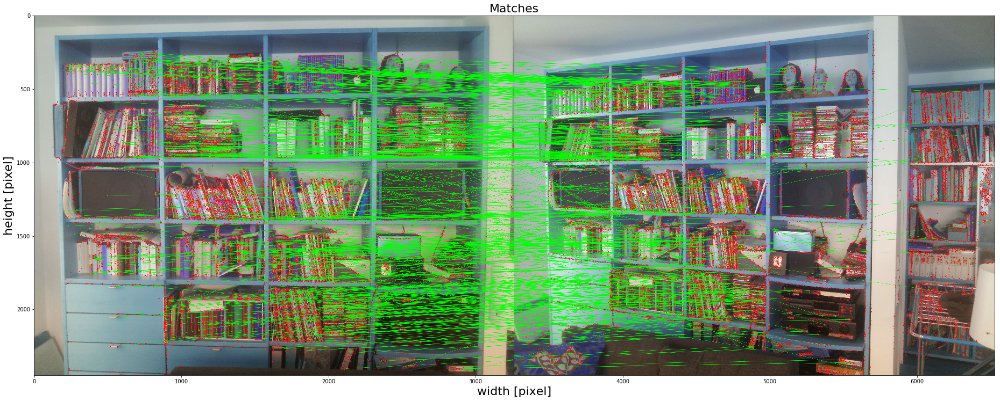

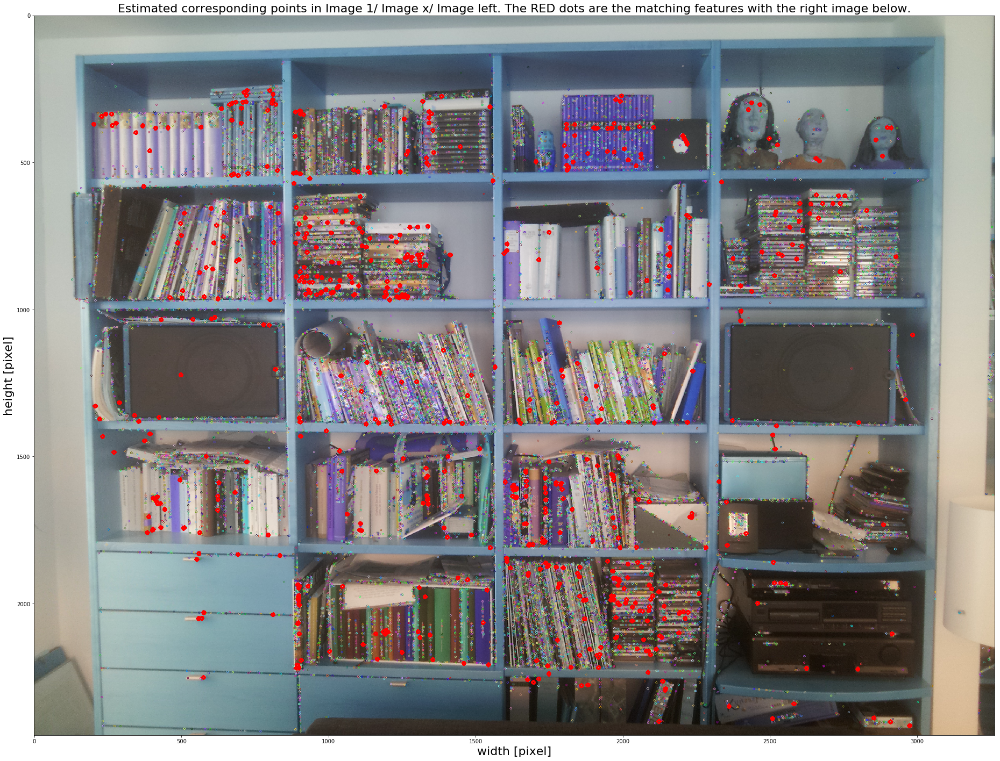

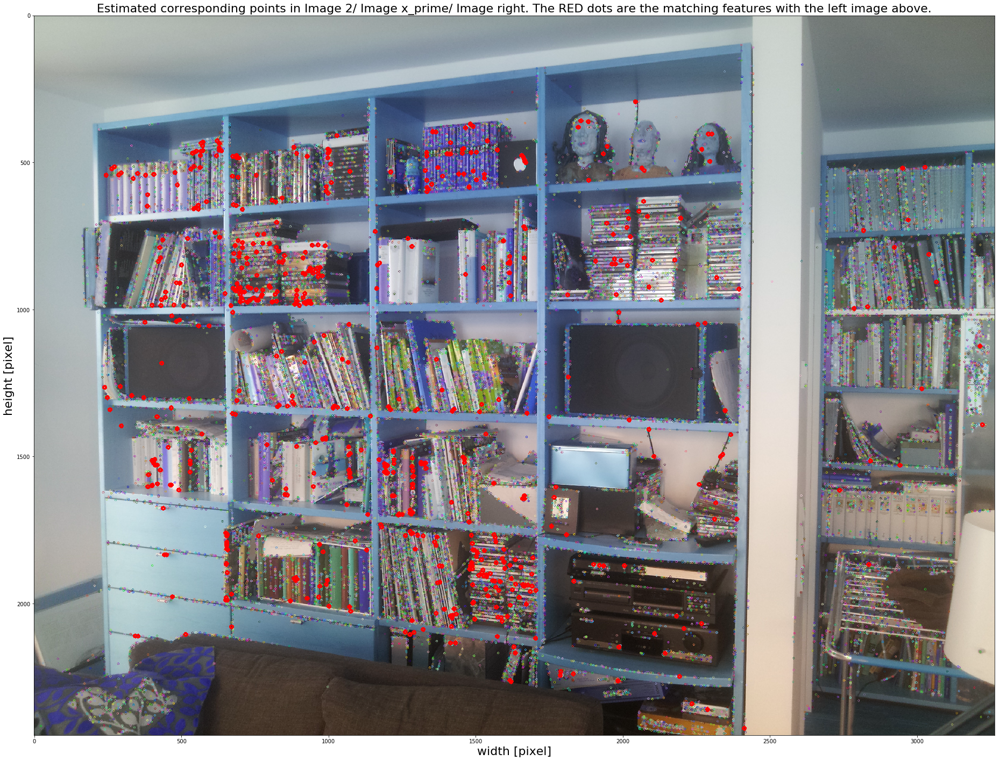

In [2]:
def run_matcher(img1, img2, kp1, kp2, des1, des2, show_matches_parallel=False):
    
    
    # FLANN parameters for matching keypoints
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    matches = flann.knnMatch(des1, des2, k=2)
    
    # Draw only good matches
    matchesMask = [[0,0] for i in range(len(matches))]
    pts_1 = []
    pts_2 = []
    
    # ratio test as per Lowe's paper
    for i, (m,n) in enumerate(matches):
        if m.distance < 0.7*n.distance:
            matchesMask[i] = [1,0]
            pts_1.append(kp1[m.queryIdx].pt)
            pts_2.append(kp2[m.trainIdx].pt)

    draw_params = dict(matchColor = (0,255,0),
                       singlePointColor = (255,0,0),
                       matchesMask = matchesMask,
                       flags = cv2.DrawMatchesFlags_DEFAULT)
    img3 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,matches,None,**draw_params)
    
    if show_matches_parallel:
        plt.figure(figsize=(32,32))
        plt.imshow(img3)
        plt.title('Matches', fontsize=22)
        plt.xlabel('width [pixel]', fontsize=22)
        plt.ylabel('height [pixel]', fontsize=22)
        plt.show()
    
    return pts_1, pts_2
    
def get_matching_features(img1, img2, kp1, kp2, des1, des2, show_matches=False):
    
    x, x_prime = run_matcher(img1, img2, kp1, kp2, des1, des2, True)
    
    if show_matches:

        for i in x:
            cv2.circle(img1,(int(i[0]), int(i[1])),5,(255,0,0), 5)
        plt.figure(figsize=(32,32))
        plt.imshow(img1)
        plt.title('Estimated corresponding points in Image 1/ Image x/ Image left. The RED dots are the matching features with the right image below.', fontsize=22)
        plt.xlabel('width [pixel]', fontsize=22)
        plt.ylabel('height [pixel]', fontsize=22)
        plt.show()

        for i in x_prime:
            cv2.circle(img2,(int(i[0]), int(i[1])),5,(255,0,0), 5)
        plt.figure(figsize=(32,32))
        plt.imshow(img2)
        plt.title('Estimated corresponding points in Image 2/ Image x_prime/ Image right. The RED dots are the matching features with the left image above.', fontsize=22)
        plt.xlabel('width [pixel]', fontsize=22)
        plt.ylabel('height [pixel]', fontsize=22)
        plt.show()
        
    inlierPts1 = list()
    inlierPts2 = list()
    for i in x:
        inlierPts1.append(list(i))
    for i in x_prime:
        inlierPts2.append(list(i))

    x = np.array(inlierPts1).T
    x_prime = np.array(inlierPts2).T
    
    return x, x_prime

x, x_prime = get_matching_features(img1, img2, kp1, kp2, des1, des2, True)

******** FOR MATCHING POINTS FROM SIFT **************
Epipole computed from F :
Left:
[-1.93255564e+04  1.53667902e+03  1.00000000e+00]
Right:
[-4.28693147e+03  1.22285157e+03  1.00000000e+00]
3D shape of world points: (3, 684)
Considering 13 pattern points for calibration
K matrix is: 
 [[ 953.357471      0.         1298.6903727 ]
 [   0.          300.54944624 1163.63219003]
 [   0.            0.            1.        ]]


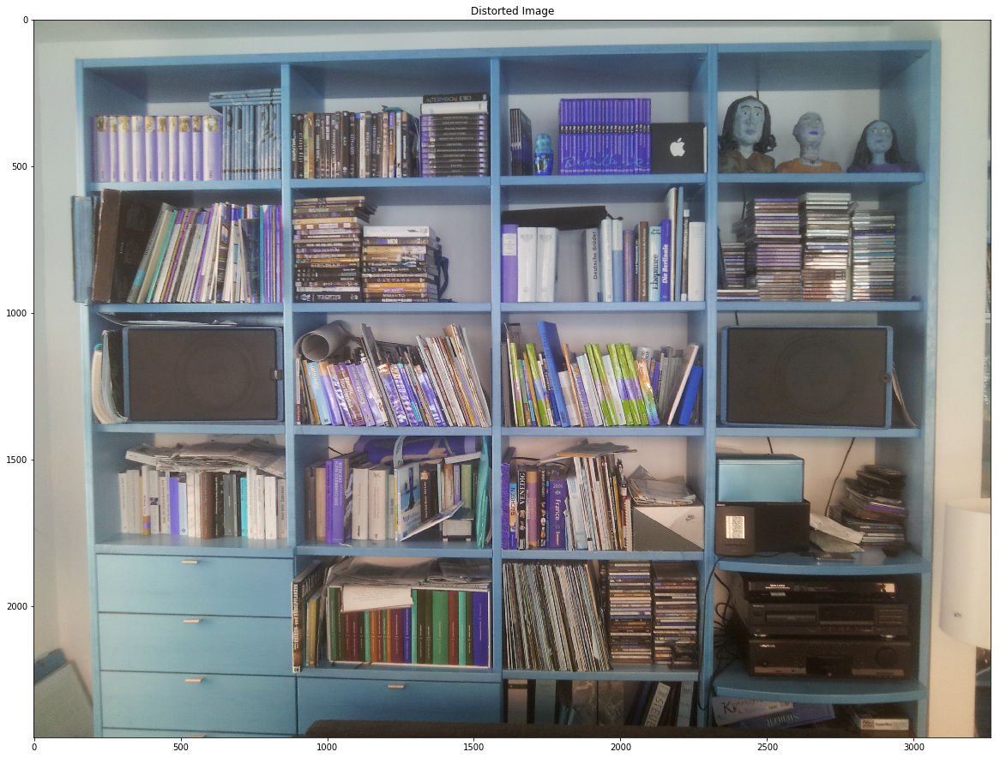

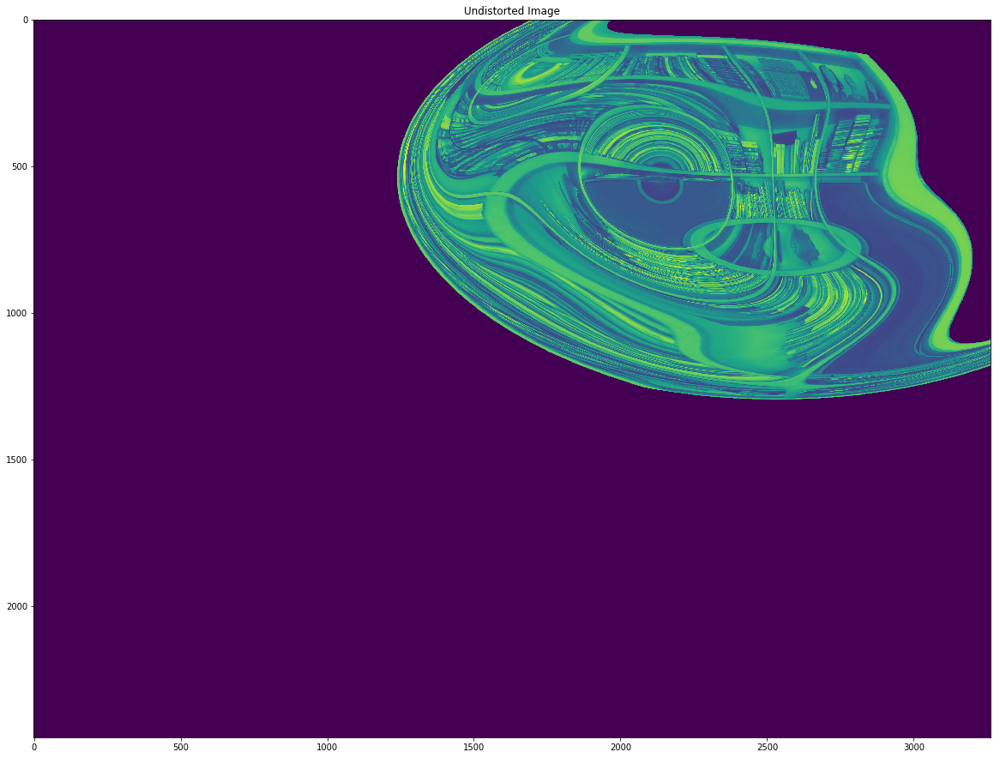

In [3]:
import typing

def find_epipole(F) -> typing.Tuple[np.ndarray]:
    '''Compute left and right null vector for finding the epipoles
    :param F: Fundamental matrix
    
    :return epipole_left: Left camera epipole
            epipole_right: Right camera epipole
    '''
    
    U, s, Vt = np.linalg.svd(F)
    V = Vt.T
    epipole_left = V[:,-1]
    epipole_left = epipole_left/epipole_left[2]
    
    
    U, s, Vt = np.linalg.svd(F.T)
    V = Vt.T
    epipole_right = V[:,-1]
    epipole_right = epipole_right/epipole_right[2]
    
    return epipole_left, epipole_right

def normalize_point(point):
    '''
    Function to normalize a given point in P2
    parameters:
        point: ndarray: A point in P2
    return:
        normalized point: ndarray: A normalized point in P2
    '''
    return point/point[-1]

def span_skew_matrix(vector):
    '''
    Function to generate skew symmetric matrix from a given vector in P2
    parameters:
        vector: ndarray: A vector in P2
    return:
        skew_matrix: ndarray: skew symmetric matrix for given vector.
    '''
    skew_matrix = [[0,-vector[2],vector[1]],[vector[2],0,-vector[0]],[-vector[1],vector[0],0]]
    return skew_matrix



def get_world_points(x, x_prime):
    '''
    Get world points given corresponding points.
    Principle:
    Compute F.
    Estimate epipole.
    Form P and P' from F.
    Triangulate world points.
    '''
    F, mask = cv2.findFundamentalMat(x.T,x_prime.T,cv2.RANSAC)
    epipole_left, epipole_right = find_epipole(F)
    P = np.hstack((np.identity(3) , np.zeros((3,1))))
    epipole = find_epipole(F)
    print('Epipole computed from F :\nLeft:\n{}\nRight:\n{}'.format(epipole[0], epipole[1]))
    e_prime = epipole[1]
    e_prime = np.reshape(e_prime,(len(e_prime),1))
    S = span_skew_matrix(e_prime)
    P_prime = np.hstack((np.dot(S,F),e_prime))
    X = cv2.triangulatePoints( P, P_prime, x, x_prime)
    objpoints = -X / X[3]
    objpoints = objpoints[:3,:]
    print('3D shape of world points:',objpoints.shape)
    
    return objpoints
    

def CameraCalibrate(x, x_prime, num_features, points_given, world_points=None, image_list=['images/20150616_074411.jpg', 'images/20150616_074444.jpg']):
    
    '''
    Given point correspondence, a camera projection matrix P is provided.
    '''
    np.set_printoptions(suppress=True)
    
    # Consider a set of pattern points
    
    print('Considering {} pattern points for calibration'.format(num_features))
    x_c = x.T
    x_prime_c = x_prime.T
    x_c = x_c[:num_features,:]
    x_prime_c = x_prime_c[:num_features,:]
    
    # Set pattern to be points in world. 
    # This is replaces the opencv obj points which is a grid for chessboard.
    
    if points_given == 'GIVEN':
        # For the points given by manual estimation, chess board pattern is used.
        world_pattern = (2,int(x_c.shape[0]/2))
        objp = np.zeros((world_pattern[0]*world_pattern[1], 3), np.float32)
        objp[:,:2] = np.mgrid[0:world_pattern[0], 0:world_pattern[1]].T.reshape(-1,2)
    else:
        # World points are estimated from the SIFT features.
        # Those world points are used for obj points.
        world_points = world_points.T
        world_points = world_points[:num_features,:].reshape(-1,3).astype('float32')
        world_points[:,-1] = 0
        objp = world_points
    
    objpoints = []
    imgpoints = []
    
    # Collect obj and image points for image 1.
    objpoints.append(objp)
    imgpoints.append(x_c.reshape(-1,2).astype('float32'))

    # Collect obj and image points for image 2.
    objpoints.append(objp)
    imgpoints.append(x_prime_c.reshape(-1,2).astype('float32'))

    img = cv2.imread(image_list[0])
    
    plt.figure(figsize=(20,20))
    plt.imshow(img)
    plt.title('Distorted Image') 
    
    img =  cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    height, width = img.shape[:2]
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, (img.shape[0], img.shape[1]), None, None)

    print('K matrix is: \n',mtx) 
    newCameraMatrix, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (width,height), 1, (width,height))
    undistorted_img = cv2.undistort(img, mtx, dist, None, newCameraMatrix)
    plt.figure(figsize=(20,20))
    plt.imshow(undistorted_img)
    plt.title('Undistorted Image')
    plt.show()
    rvecs = np.asarray(rvecs)
    rvecs = np.mean(rvecs, axis=0).T
    rotation_mat = np.zeros(shape=(3, 3))
    R = cv2.Rodrigues(rvecs, rotation_mat)[0]
    
    P = np.column_stack((np.matmul(mtx,R), tvecs[0]))
    
    return P

print('******** FOR MATCHING POINTS FROM SIFT **************')

world_points = get_world_points(x, x_prime)
P_using_sift = CameraCalibrate(x, x_prime, 13, 'SIFT', world_points)


******** FOR MATCHING POINTS GIVEN **************
Considering 10 pattern points for calibration
K matrix is: 
 [[ 618.34343186    0.         1024.06198359]
 [   0.          741.98089047 1164.82773184]
 [   0.            0.            1.        ]]


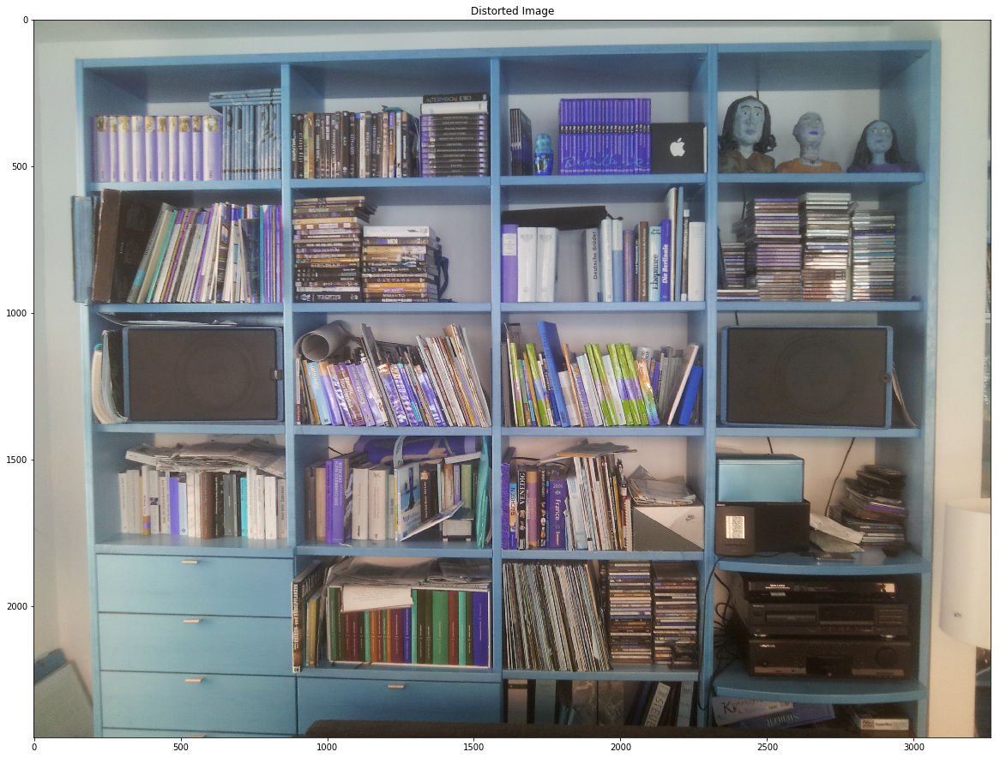

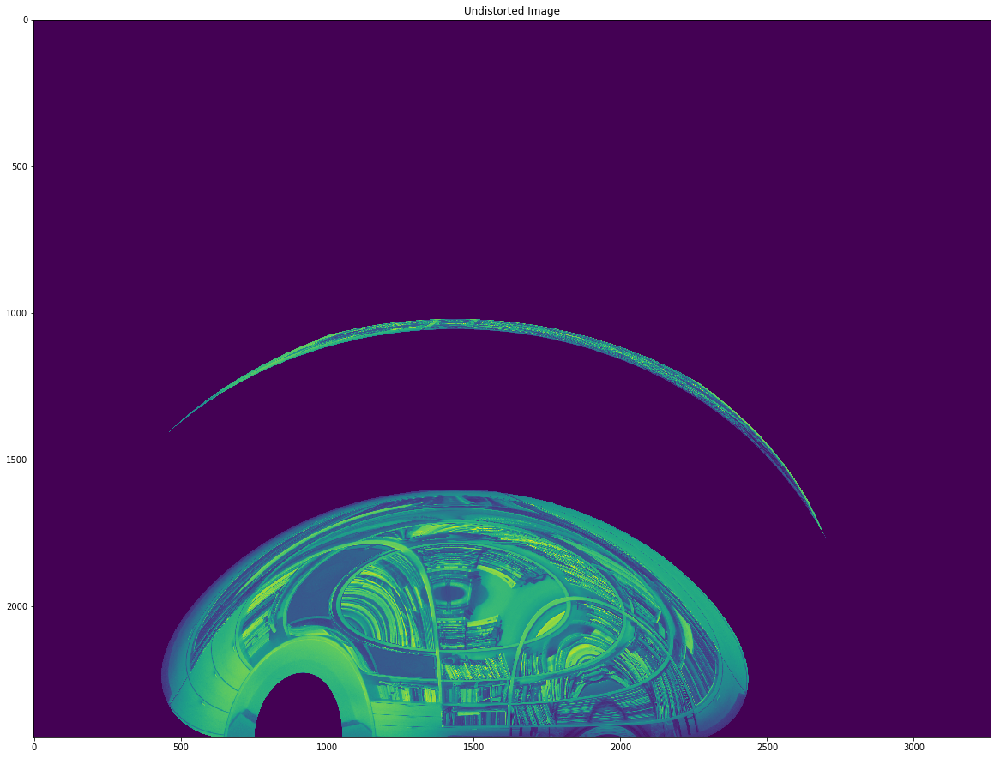

In [4]:
import pandas as pd

print('******** FOR MATCHING POINTS GIVEN **************')
def extract_points(dataframe):
    '''
    Function to extract x and y point from given dataframe
    parameters:
        dataframe: pandas dataframe: Dataframe consists of points from images.
    return:
        point_list: list: A list of all points from an image
    '''
    points_x = dataframe.iloc[:,1]
    points_y = dataframe.iloc[:,2]
    points_list = []
    for i,j in zip(points_x,points_y):
        points_list.append([i,j])
    return points_list

shelf0_with_line = pd.read_csv("shelf0Points.csv", header=None )
shelfrr_with_line = pd.read_csv("shelfrrPoints.csv", header=None)

inlierPts1 = np.array(extract_points(shelf0_with_line)).T
inlierPts2 = np.array(extract_points(shelfrr_with_line)).T

# world_points_givenmanual = get_world_points(inlierPts1, inlierPts2)
P_givenmanual = CameraCalibrate(inlierPts1, inlierPts2, 10, 'GIVEN')


## Challenges:

1. The distortion coefficients are not properly extracted from the given correspondence because the undistort is not working as expected. 
2. The reason is world points estimated by triangulation is not repeatable and the values are differring during execution. 
3. One of the reasons for using the **grid pattern for the object points** in the given corresponding point case (case 2) is the world points are not properly extracted by triangulation.


## Lessons learned:

1. Depending on the task, what we need to study and what we are studying, **try to use gray scale images** for reducing computational crunches.  
2. Handle jupyter notebooks efficiently to accommodate huge tasks with more images and points.


## Task2: Use some point correspondences to draw epipolar lines INTO the pictures as overlays. 

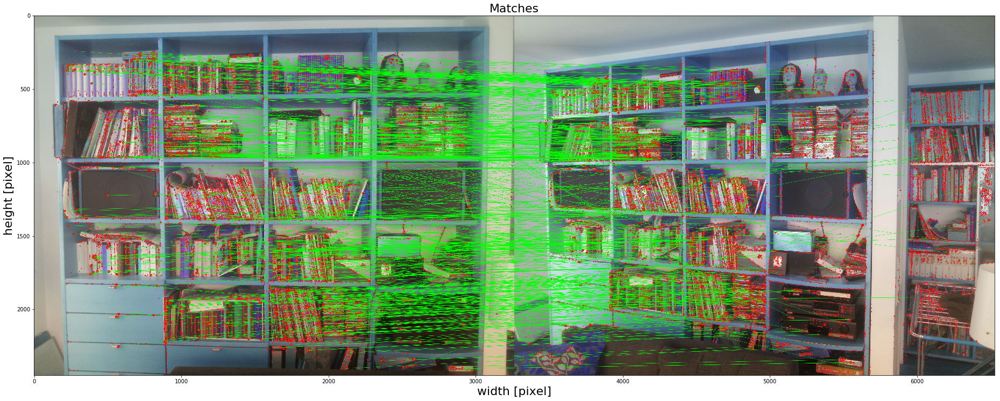


*********** OUR IMPLEMENTATION************

Fundamental matrix computed by our implementation, F:
 [[-0.00000004 -0.00000175  0.00255378]
 [ 0.0000017   0.00000002 -0.00502592]
 [-0.00228289  0.00407889  1.        ]]
F is computed by our implementation in 0.06389 seconds.

*********** OPENCV IMPLEMENTATION************

Fundamental matrix computed by OpenCV implementation, F_cv:
 [[-0.00000004 -0.00000175  0.00255378]
 [ 0.0000017   0.00000002 -0.00502592]
 [-0.00228289  0.00407889  1.        ]]
F is computed by OpenCV implementation in 0.00033 seconds.
Epipole for F computed by our implementation:
Left:
[2938.73246383 1399.59820675    1.        ]
Right:
[2348.83777884 1392.46493134    1.        ]
Epipole for F computed by OpenCV implementation:
Left:
[2938.73246383 1399.59820675    1.        ]
Right:
[2348.83777884 1392.46493134    1.        ]
IMAGE 1 shape: (2448, 3264, 3)
IMAGE 2 shape: (2448, 3264, 3)


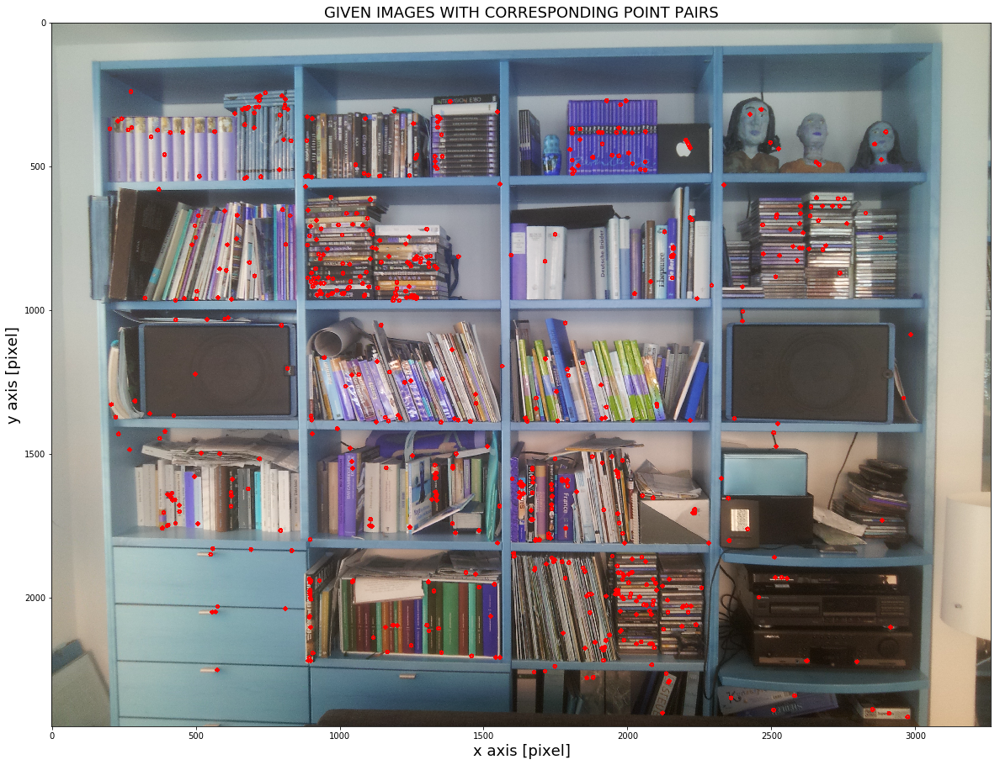

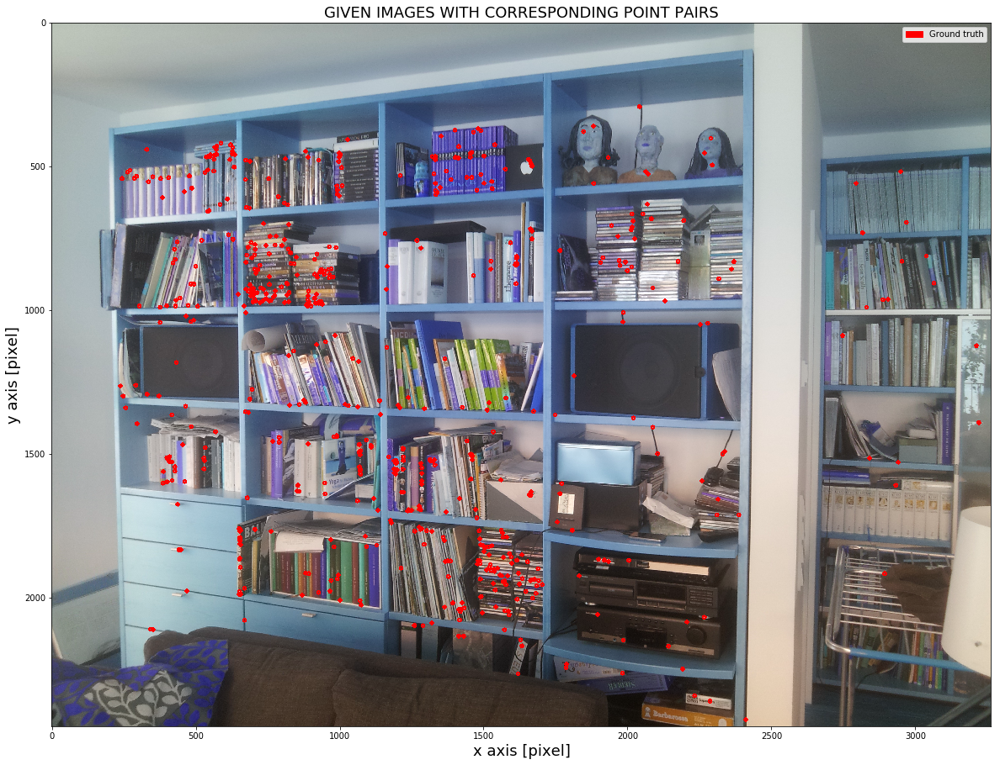

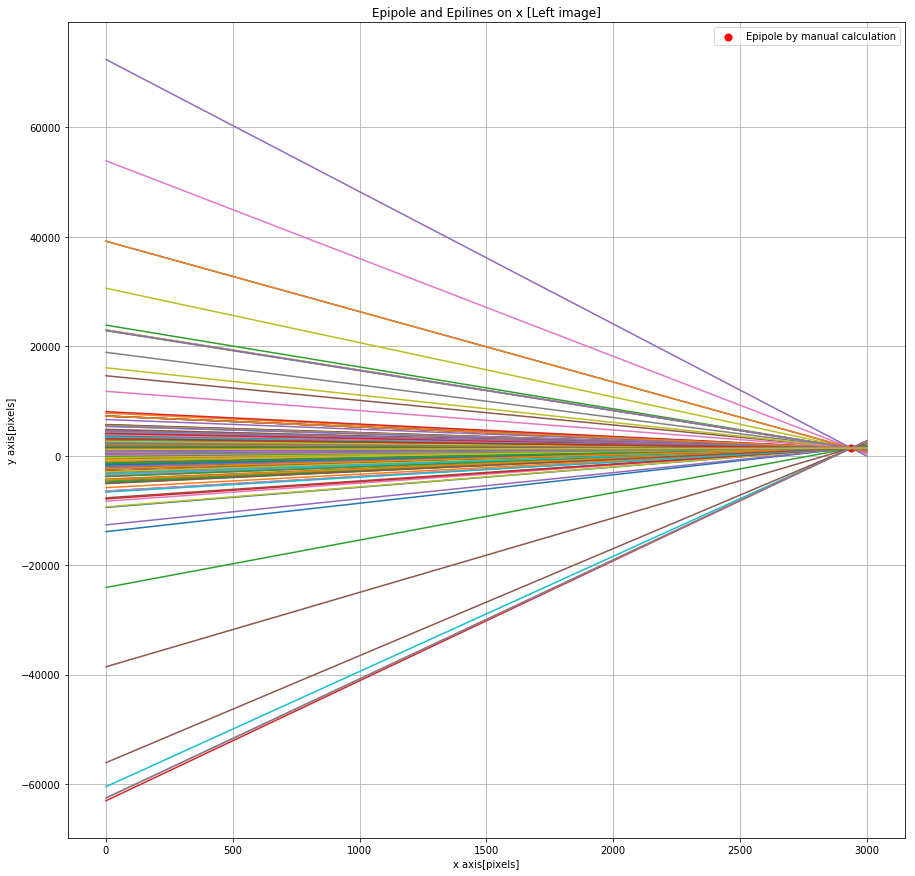

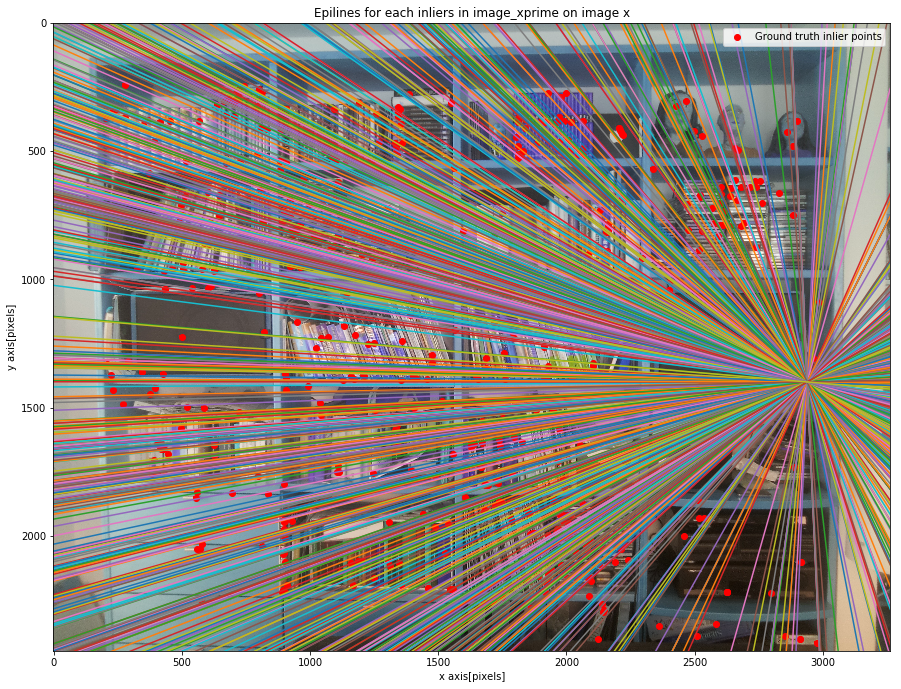

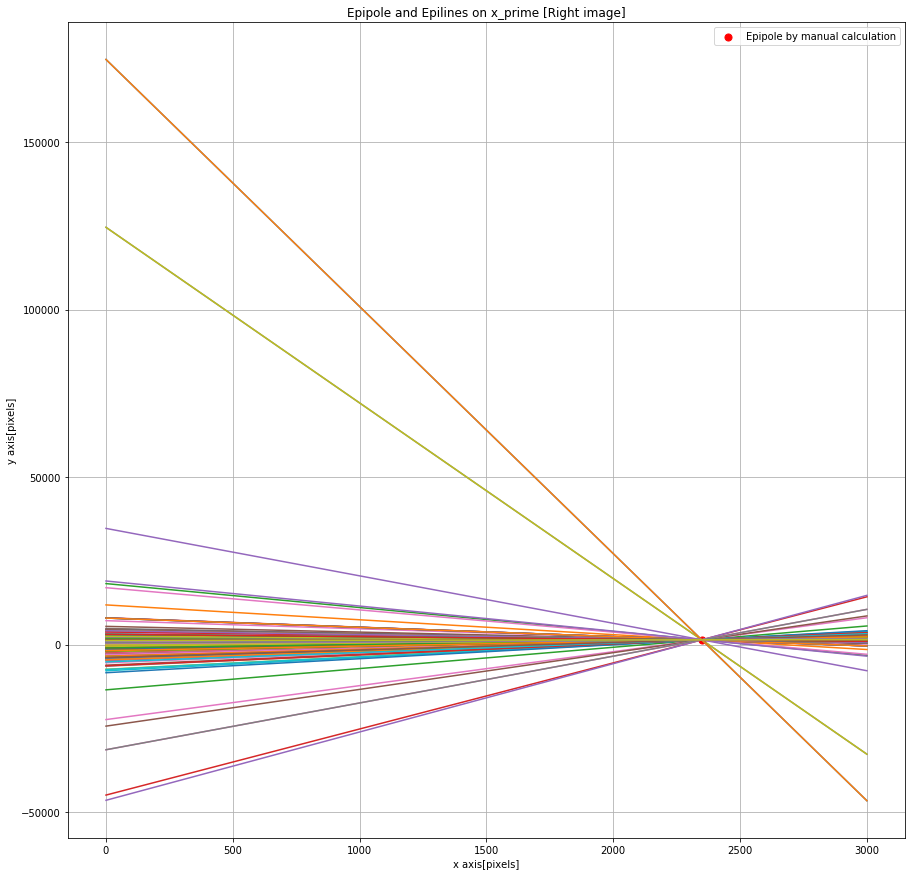

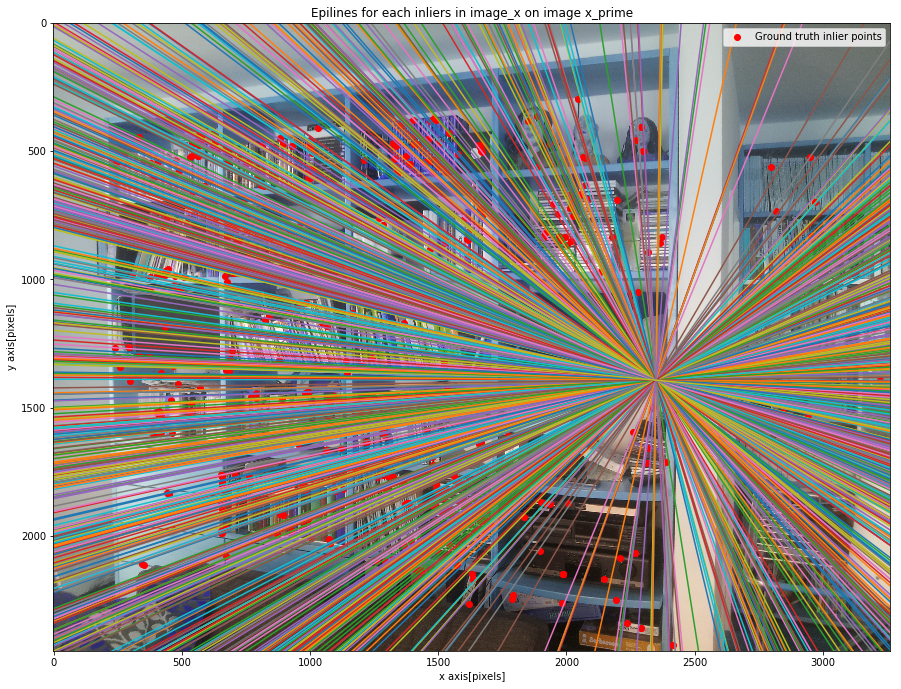

In [5]:
# For the images given using the F computation by our implementation
# Epilines convergence to a epipoles is illustrated
# This cell contains the implementation using SIFT feature matches.
import numpy as np
import matplotlib.pyplot as plt
import cv2
import typing
from copy import deepcopy
import re
import matplotlib.patches as mpatches
import time

class Compute_Fundamental_matrix():
    
    def __init__(self):
        np.set_printoptions(suppress=True)
    
    
    def normalize(self, x: np.ndarray) -> np.ndarray:
        
        '''
        Normalizes a given matrix, x by performing similarity transformation.
        Now the centroid of the new points has (0,0)^T and the average distance 
        from the origin is square.root(2)
        :param x: Points in an image to be normalized.
        :return x_bar: Normalized points in the image.
                T: Similarity transformation matrix.
        '''

        x_bar = np.asarray(x)
        m = np.mean(x,1)

        deno = list()

        for i in x.transpose():
            deno.append(list(i-m))
        deno = np.square(np.array(deno))
        total = 0
        for i in deno:
            total = sum(i)**(1/2.) + total

        s = 2**(1/2)/(total/len(deno))

        T = np.array([[s, 0, -s*m[0]], [0, s, -s*m[1]], [0, 0, 1]])

        x = np.vstack((x, np.ones((1,x.shape[1]))))

        x_bar = np.dot(T, x)
        
        return x_bar, T
    
    def Fundamental_matrix(self, x, x_bar, to_P2 = False):
        
        '''Computing Fundamental matrix F
        :param x: left image points.
               x_prime: right image points corresponding with x points.
               to_P2: Whether point should be converted to P2.
        : return F: Fundamental matrix mapping x points to epiline in right image.  
        '''
        
        if to_P2:
            x = np.vstack((x, np.ones((1, x.shape[1]))))
            x_bar = np.vstack((x_bar, np.ones((1, x_bar.shape[1]))))
        
        # Initializations for A matrix
        A = list()
        
        # Forming A matrix as provided in Hartley and zisserman multiple view geometry
        
        # x1'x1, x1'y1, x1', y1'x1, y1'y1, y1', x1, y1, 1

        for i,j in zip(x.transpose(), x_bar.transpose()):
            row = [j[0]*i[0], j[0]*i[1], j[0], j[1]*i[0], j[1]*i[1], j[1], i[0], i[1], 1]
            A.append(row)

        A = np.array(A)

        # Ah = 0 ;Minimizing ||Ah|| such that ||h||=1
        # Solution by SVD        
        U,s,Vt = np.linalg.svd(A)
        V=Vt.T
        F_cap=V[:,-1] # Last column of V corresponding eigen vector to the smallest eigen value
        
        F_cap = np.reshape(F_cap,(3,3))

        return F_cap
    
    def enforce_singularity(self, F_cap, r_to_l):
        
        '''
        Ensure det(F) = 0 because F is a rank 2 matrix.
        :param F_cap: F to be made singular
               r_to_l: whether the mapping is from right to left image.
        :return F_cap_prime: singular F.                       
        '''
        
        U, s, Vt = np.linalg.svd(F_cap)
        s[2] = 0
        s = np.diag(s)
        if r_to_l:
            F_cap_prime = np.dot(U,np.dot(s, Vt)).T
        else:
            F_cap_prime = np.dot(U,np.dot(s, Vt))
        
        return F_cap_prime                
    
    
    def desired_F(self, T_bar, T_prime_bar, F_normalized):
        
        '''
        Used for finding F in unnormalized original co-ordinates from normalized F by performing,
        F = transpose(T') F_normalized T.
        '''
        desired_F = np.dot((T_prime_bar.T),(np.dot(F_normalized, T_bar)))
        
        desired_F = desired_F/desired_F[-1][-1]
        
        return desired_F
    
    
def estimateFundamentalMatrix(x, x_prime):
    
    '''
    Computes fundamental matrix, F.
    :param x: left image points.
           x_prime: right image points corresponding with x points.
    : return F: Fundamental matrix mapping x points to epiline in right image.    
    '''

    F = Compute_Fundamental_matrix()

    # Normalize x to overcome the numerical calculation issues.
    x_bar, T_bar = F.normalize(x)

    # Normalize x' to overcome the numerical calculation issues.
    x_prime_bar, T_prime_bar = F.normalize(x_prime)

    # Compute Fundamental matrix.
    F_cap = F.Fundamental_matrix(x_bar, x_prime_bar)

    # Enfore singularity constraint det(F_cap) = 0.
    F_cap_prime = F.enforce_singularity(F_cap, False) # Set to l_to_r always.

    # Desired F unnormalized by using the similartity transformations done to the input data.
    F = F.desired_F(T_bar, T_prime_bar, F_cap_prime)
    
    return F

def find_epipole(F) -> typing.Tuple[np.ndarray]:
    '''Compute left and right null vector for finding the epipoles
    :param F: Fundamental matrix
    
    :return epipole_left: Left camera epipole
            epipole_right: Right camera epipole
    '''
    
    U, s, Vt = np.linalg.svd(F)
    V = Vt.T
    epipole_left = V[:,-1]
    epipole_left = epipole_left/epipole_left[2]
    
    
    U, s, Vt = np.linalg.svd(F.T)
    V = Vt.T
    epipole_right = V[:,-1]
    epipole_right = epipole_right/epipole_right[2]
    
    return epipole_left, epipole_right

    
    
img1_name = 'images/20150616_074411.jpg'
img2_name = 'images/20150616_074444.jpg'
x, x_prime = get_matching_features(img1, img2, kp1, kp2, des1, des2, False)

inlierPts1, inlierPts2 = x, x_prime

print('\n*********** OUR IMPLEMENTATION************\n')
start = time.time()
fNorm8Point = estimateFundamentalMatrix(inlierPts1, inlierPts2)
end = time.time()
F = fNorm8Point
print("Fundamental matrix computed by our implementation, F:\n",F)
print("F is computed by our implementation in {} seconds.". format(round(end-start,5)))

print('\n*********** OPENCV IMPLEMENTATION************\n')
start = time.time()
F_cv, mask = cv2.findFundamentalMat(inlierPts1.T, inlierPts2.T, cv2.FM_8POINT)
end = time.time()
print("Fundamental matrix computed by OpenCV implementation, F_cv:\n",F_cv)
print("F is computed by OpenCV implementation in {} seconds.". format(round(end-start,5)))


epipole = find_epipole(F)
print('Epipole for F computed by our implementation:\nLeft:\n{}\nRight:\n{}'.format(epipole[0], epipole[1]))
epipole_cv = find_epipole(F_cv)
print('Epipole for F computed by OpenCV implementation:\nLeft:\n{}\nRight:\n{}'. format(epipole_cv[0], epipole_cv[1]))


def draw_epilines(F, img1, img2, inlierPts1, inlierPts2):
    '''
    Draws epilines on another image for the points given in an image using F given.
    Images are plotted for illustration purposes. 
    Epipoles and the corresponding epilines are plotted in the graph.
    Epilines are plotted in the image directly.
    
    :param F: Fundamental matrix mapping points in left image to lines in right image.
           img1: Left image (x image)
           img2: Right image (x_prime image)
           inlierPts1: Points in left image.
           inlierPts2: Points in right image corresponding to left image points.
    '''
    
    x = np.vstack((inlierPts1, np.ones((1, inlierPts1.shape[1]))))
    x_prime = np.vstack((inlierPts2, np.ones((1, inlierPts2.shape[1]))))
    
    epiline_on_xprime = F@x
    epiline_on_x = F.T@x_prime

    span = np.linspace(0, 3000 , 61)
    span_img1 = range(img1.shape[1])
    span_img2 = range(img2.shape[1])
    
    plt.figure(figsize=(15,15))
    for n,i in enumerate(range(x.shape[1])):
        y = (-epiline_on_x[2][n] -epiline_on_x[0][n]*span)/ (epiline_on_x[1][n]) 
        plt.plot(span, y)
        plt.title('Epipole and Epilines on x [Left image]')
        plt.grid()
    plt.scatter(epipole[0][0], epipole[0][1], c ='red', s=50, label='Epipole by manual calculation')
    plt.legend()
    plt.xlabel('x axis[pixels]')
    plt.ylabel('y axis[pixels]')
    plt.show()
        
    plt.figure(figsize=(15,15))
    for n,i in enumerate(range(x.shape[1])):
        y = (-epiline_on_x[2][n] -epiline_on_x[0][n]*span_img1)/ (epiline_on_x[1][n]) 
        plt.plot(span_img1, y)
    plt.scatter(inlierPts1[0],inlierPts1[1], c='r', label='Ground truth inlier points')
    plt.imshow(img1, origin='upper')
    plt.ylim(img1.shape[0], 0)
    plt.legend()
    plt.title('Epilines for each inliers in image_xprime on image x')
    plt.xlabel('x axis[pixels]')
    plt.ylabel('y axis[pixels]')
    plt.show()
    
    plt.figure(figsize=(15,15))
    for n,i in enumerate(range(x_prime.shape[1])):
        y = (-epiline_on_xprime[2][n] -epiline_on_xprime[0][n]*span)/ (epiline_on_xprime[1][n]) 
        plt.plot(span, y)
        plt.title('Epipole and Epilines on x_prime [Right image]')
        plt.grid()
    plt.scatter(epipole[1][0], epipole[1][1], c ='red', s=50, label='Epipole by manual calculation')
    plt.legend()
    plt.xlabel('x axis[pixels]')
    plt.ylabel('y axis[pixels]')
    plt.show()
    
    plt.figure(figsize=(15,15))
    for n,i in enumerate(range(x_prime.shape[1])):
        y = (-epiline_on_xprime[2][n] -epiline_on_xprime[0][n]*span_img2)/ (epiline_on_xprime[1][n]) 
        plt.plot(span_img2, y)
    plt.scatter(inlierPts2[0],inlierPts2[1], c='r', label='Ground truth inlier points')
    plt.imshow(img2, origin='upper')
    plt.ylim(img2.shape[0], 0)
    plt.legend()
    plt.title('Epilines for each inliers in image_x on image x_prime')
    plt.xlabel('x axis[pixels]')
    plt.ylabel('y axis[pixels]')
    plt.show()
    
    
# Get initial corresponding points.
fNorm8Point = estimateFundamentalMatrix(inlierPts1, inlierPts2)
img1_name = 'images/20150616_074411.jpg'
img2_name = 'images/20150616_074444.jpg'
img1 = cv2.imread(img1_name)
img2 = cv2.imread(img2_name)
print("IMAGE 1 shape:",img1.shape)
print("IMAGE 2 shape:",img2.shape)
# Displaying corresponding points
for i in zip(inlierPts1[0], inlierPts1[1]):
    cv2.circle(img1,(int(i[0]), int(i[1])),5,(255,0,0), 5)
plt.figure(figsize=(20,20))
plt.imshow(img1)
plt.xlabel('x axis [pixel]', fontsize=18)
plt.ylabel('y axis [pixel]', fontsize=18)
plt.title('GIVEN IMAGES WITH CORRESPONDING POINT PAIRS', fontsize=18)
for i in zip(inlierPts2[0], inlierPts2[1]):
    cv2.circle(img2,(int(i[0]), int(i[1])),5,(255,0,0), 5)
plt.figure(figsize=(20,20))
plt.imshow(img2)
plt.xlabel('x axis [pixel]', fontsize=18)
plt.ylabel('y axis [pixel]', fontsize=18)
plt.title('GIVEN IMAGES WITH CORRESPONDING POINT PAIRS', fontsize=18)
red_patch = mpatches.Patch(color='red', label='Ground truth')
plt.legend(handles=[red_patch])
plt.show()

draw_epilines(fNorm8Point, img1, img2, x, x_prime)



*********** OUR IMPLEMENTATION************

Fundamental matrix computed by our implementation, F:
 [[ 0.00000006  0.00000024 -0.00100308]
 [ 0.00000005  0.00000002 -0.00309774]
 [ 0.00036864  0.00223654  1.        ]]
F is computed by our implementation in 0.00147 seconds.

*********** OPENCV IMPLEMENTATION************

Fundamental matrix computed by OpenCV implementation, F_cv:
 [[ 0.00000006  0.00000024 -0.00100308]
 [ 0.00000005  0.00000002 -0.00309774]
 [ 0.00036864  0.00223654  1.        ]]
F is computed by OpenCV implementation in 0.00056 seconds.
Epipole for F computed by our implementation:
Left:
[ 71559.29132696 -12241.85029315      1.        ]
Right:
[-9495.49135199  3397.54322571     1.        ]
Epipole for F computed by OpenCV implementation:
Left:
[ 71559.2914652 -12241.8503179      1.       ]
Right:
[-9495.49134761  3397.54322448     1.        ]
IMAGE 1 shape: (2448, 3264, 3)
IMAGE 2 shape: (2448, 3264, 3)


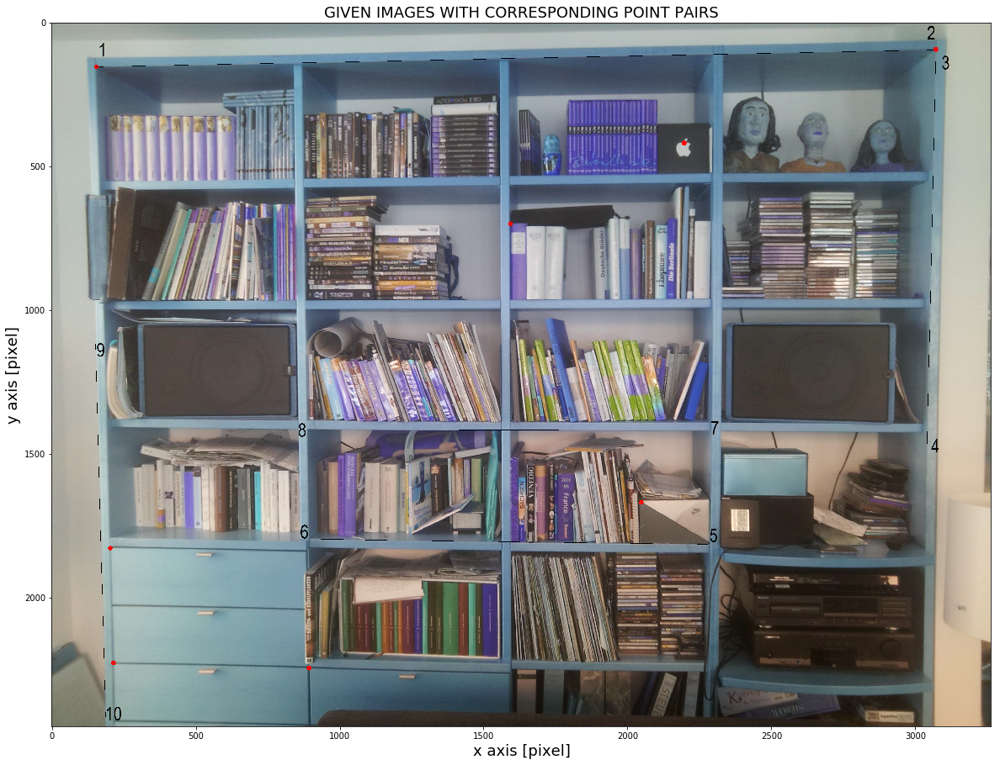

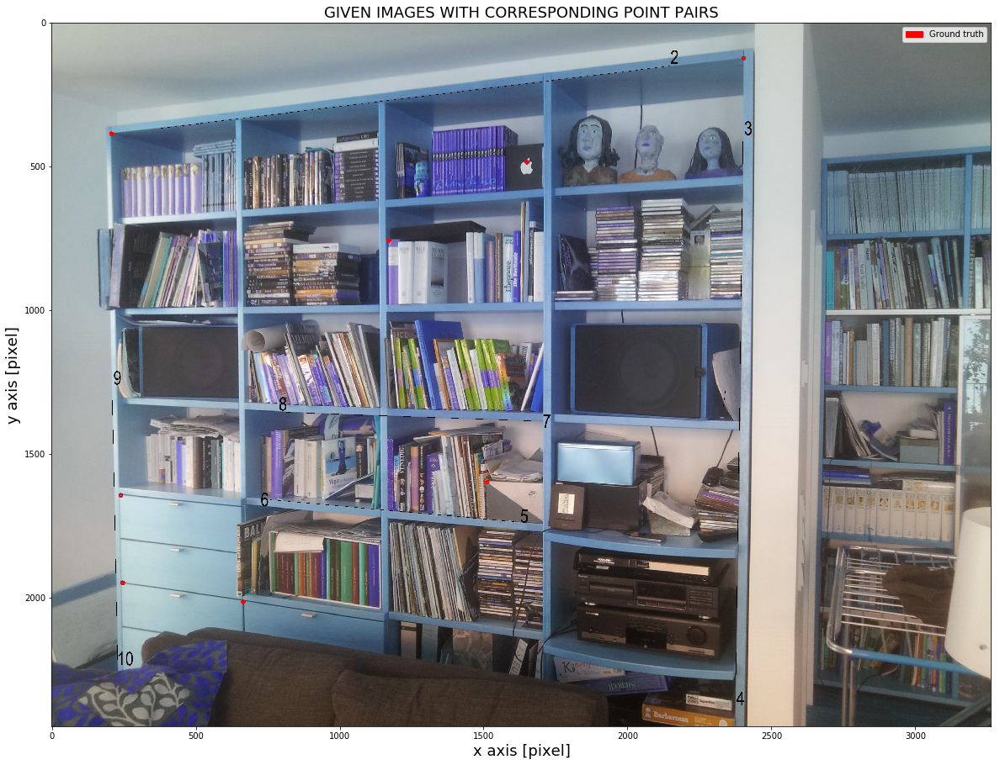

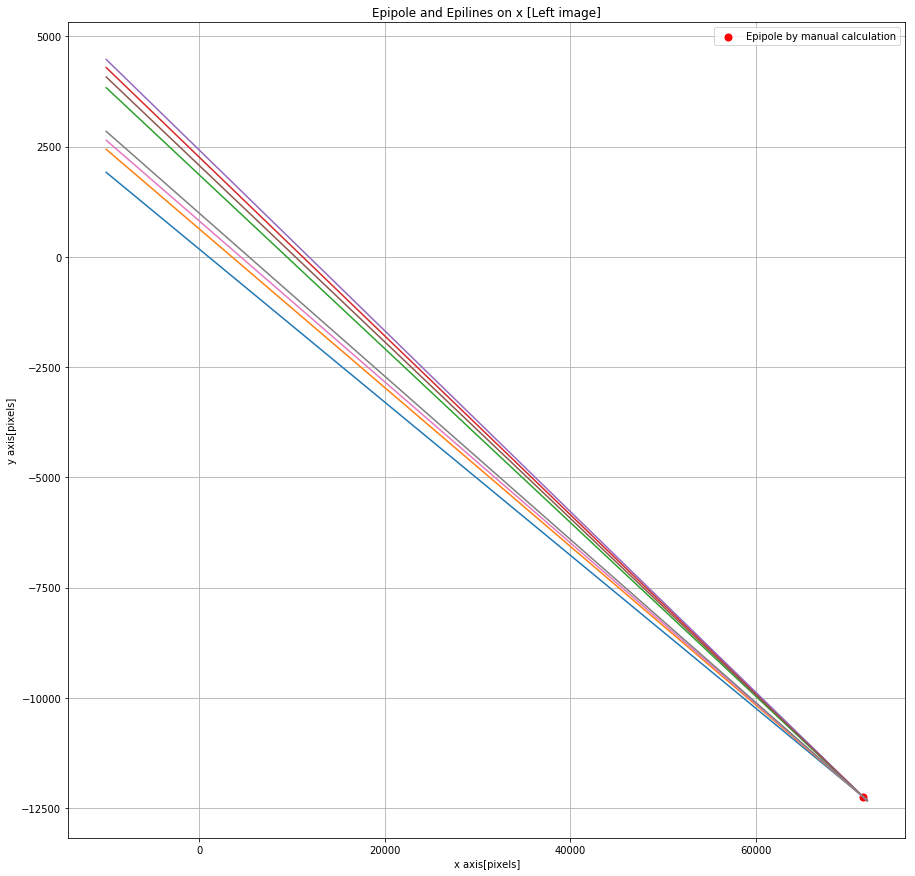

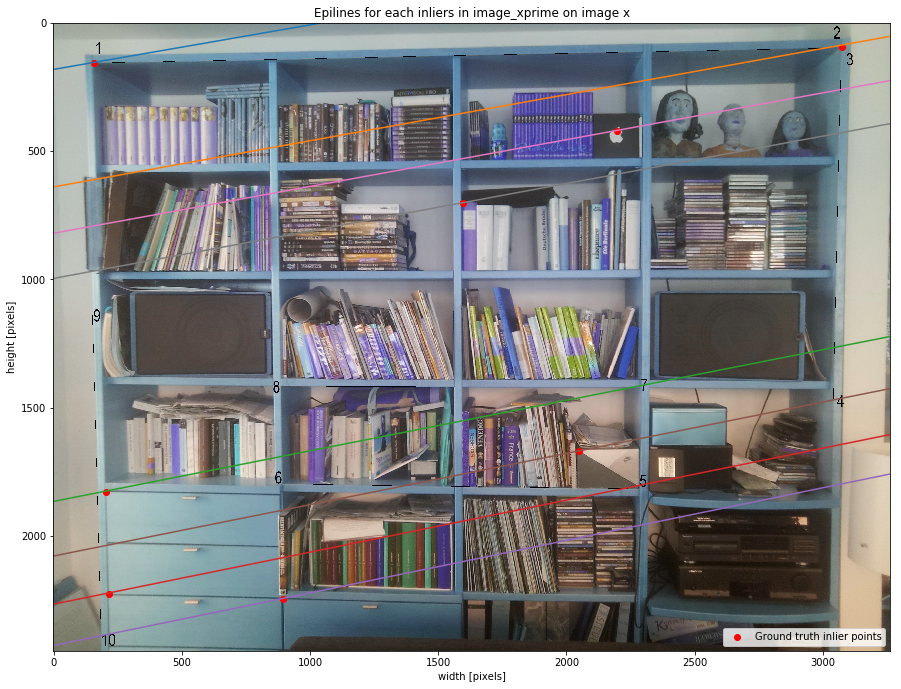

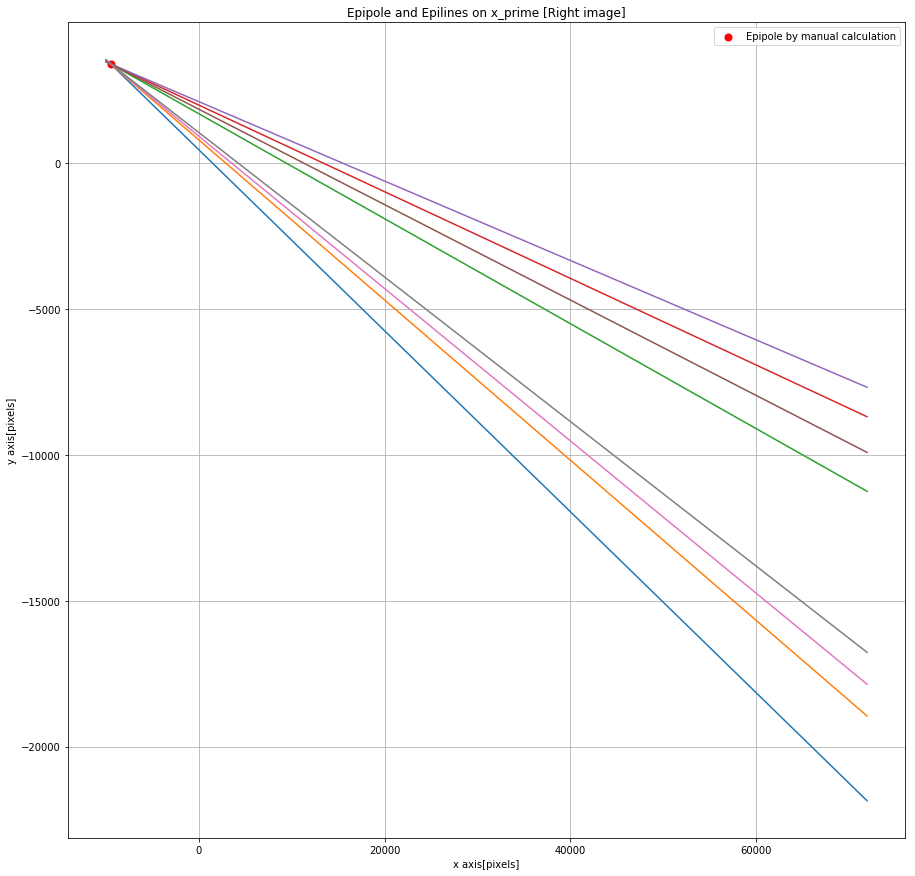

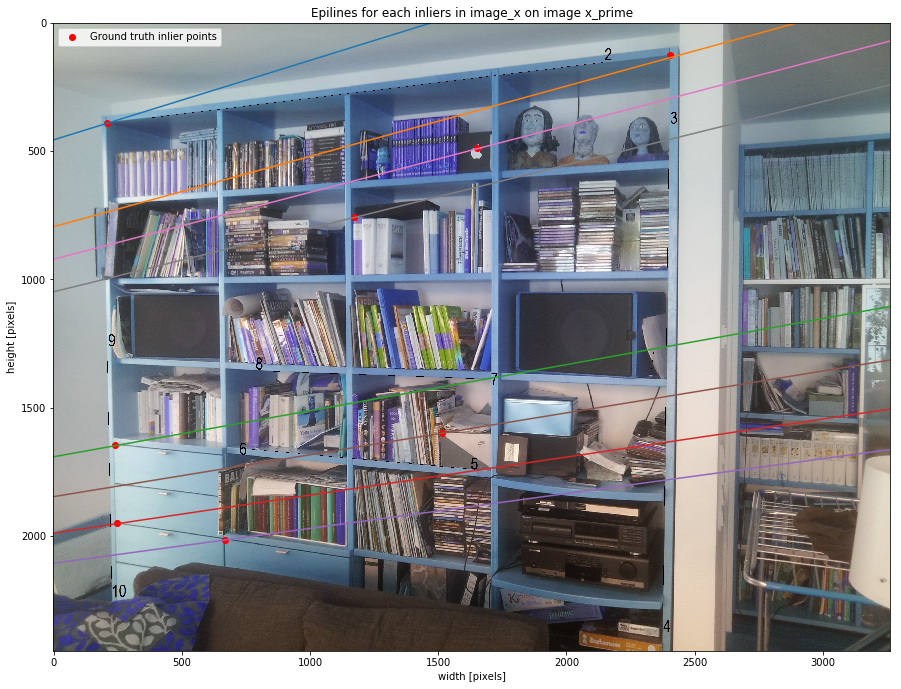

In [6]:
# This cell contains the implementation using the manually given feature matching points in the CSV files.

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
import typing
from copy import deepcopy
import re
import matplotlib.patches as mpatches
import time

def extract_points(dataframe):
    '''
    Function to extract x and y point from given dataframe
    parameters:
        dataframe: pandas dataframe: Dataframe consists of points from images.
    return:
        point_list: list: A list of all points from an image
    '''
    points_x = dataframe.iloc[:,1]
    points_y = dataframe.iloc[:,2]
    points_list = []
    for i,j in zip(points_x,points_y):
        points_list.append([i,j])
    return points_list

shelf0_with_line = pd.read_csv("shelf0Points.csv", header=None)
shelfrr_with_line = pd.read_csv("shelfrrPoints.csv", header=None)

inlierPts1 = np.array(extract_points(shelf0_with_line)).T
inlierPts2 = np.array(extract_points(shelfrr_with_line)).T

print('\n*********** OUR IMPLEMENTATION************\n')
start = time.time()
fNorm8Point = estimateFundamentalMatrix(inlierPts1, inlierPts2)
end = time.time()
F = fNorm8Point
print("Fundamental matrix computed by our implementation, F:\n",F)
print("F is computed by our implementation in {} seconds.". format(round(end-start,5)))
corresponding_points = '../FMatriximages/FMatriximages/7/FMatrixCorrPointsStereo.txt'

print('\n*********** OPENCV IMPLEMENTATION************\n')
start = time.time()
F_cv, mask = cv2.findFundamentalMat(inlierPts1.T, inlierPts2.T, cv2.FM_8POINT)
end = time.time()
print("Fundamental matrix computed by OpenCV implementation, F_cv:\n",F_cv)
print("F is computed by OpenCV implementation in {} seconds.". format(round(end-start,5)))


epipole = find_epipole(F)
print('Epipole for F computed by our implementation:\nLeft:\n{}\nRight:\n{}'.format(epipole[0], epipole[1]))
epipole_cv = find_epipole(F_cv)
print('Epipole for F computed by OpenCV implementation:\nLeft:\n{}\nRight:\n{}'. format(epipole_cv[0], epipole_cv[1]))



def draw_epilines(F, img1, img2, inlierPts1, inlierPts2):
    '''
    Draws epilines on another image for the points given in an image using F given.
    Images are plotted for illustration purposes. 
    Epipoles and the corresponding epilines are plotted in the graph.
    Epilines are plotted in the image directly.
    
    :param F: Fundamental matrix mapping points in left image to lines in right image.
           img1: Left image (x image)
           img2: Right image (x_prime image)
           inlierPts1: Points in left image.
           inlierPts2: Points in right image corresponding to left image points.
    '''
    
    x = np.vstack((inlierPts1, np.ones((1, inlierPts1.shape[1]))))
    x_prime = np.vstack((inlierPts2, np.ones((1, inlierPts2.shape[1]))))
    
    epiline_on_xprime = F@x
    epiline_on_x = F.T@x_prime

    span = np.linspace(-10000, 72000 , 61)
    span_img1 = range(img1.shape[1])
    span_img2 = range(img2.shape[1])
    
    plt.figure(figsize=(15,15))
    for n,i in enumerate(range(x.shape[1])):
        y = (-epiline_on_x[2][n] -epiline_on_x[0][n]*span)/ (epiline_on_x[1][n]) 
        plt.plot(span, y)
        plt.grid(True)
        plt.title('Epipole and Epilines on x [Left image]')
        
    plt.scatter(epipole[0][0], epipole[0][1], c ='red', s=50, label='Epipole by manual calculation')
    plt.legend()
    plt.xlabel('x axis[pixels]')
    plt.ylabel('y axis[pixels]')
    plt.show()
        
    plt.figure(figsize=(15,15))
    for n,i in enumerate(range(x.shape[1])):
        y = (-epiline_on_x[2][n] -epiline_on_x[0][n]*span_img1)/ (epiline_on_x[1][n]) 
        plt.plot(span_img1, y)
    plt.scatter(inlierPts1[0],inlierPts1[1], c='r', label='Ground truth inlier points')
    plt.imshow(img1, origin='upper')
    plt.ylim(img1.shape[0], 0)
    plt.legend()
    plt.title('Epilines for each inliers in image_xprime on image x')
    plt.xlabel('width [pixels]')
    plt.ylabel('height [pixels]')
    plt.show()
    
    plt.figure(figsize=(15,15))
    for n,i in enumerate(range(x_prime.shape[1])):
        y = (-epiline_on_xprime[2][n] -epiline_on_xprime[0][n]*span)/ (epiline_on_xprime[1][n]) 
        plt.plot(span, y)
        plt.title('Epipole and Epilines on x_prime [Right image]')
        plt.grid(True)
    plt.scatter(epipole[1][0], epipole[1][1], c ='red', s=50, label='Epipole by manual calculation')
    plt.legend()
    plt.xlabel('x axis[pixels]')
    plt.ylabel('y axis[pixels]')
    plt.show()
    
    plt.figure(figsize=(15,15))
    for n,i in enumerate(range(x_prime.shape[1])):
        y = (-epiline_on_xprime[2][n] -epiline_on_xprime[0][n]*span_img2)/ (epiline_on_xprime[1][n]) 
        plt.plot(span_img2, y)
    plt.scatter(inlierPts2[0],inlierPts2[1], c='r', label='Ground truth inlier points')
    plt.imshow(img2, origin='upper')
    plt.ylim(img2.shape[0], 0)
    plt.legend()
    plt.title('Epilines for each inliers in image_x on image x_prime')
    plt.xlabel('width [pixels]')
    plt.ylabel('height [pixels]')
    plt.show()
    
# Get initial corresponding points.
fNorm8Point = estimateFundamentalMatrix(inlierPts1, inlierPts2)
img1_name = 'images/shelf0CalibratedwithLines.jpg'
img2_name = 'images/shelfrrCalibratedwithLines.jpg'
img1 = cv2.imread(img1_name)
img2 = cv2.imread(img2_name)
print("IMAGE 1 shape:",img1.shape)
print("IMAGE 2 shape:",img2.shape)
# Displaying corresponding points
for i in zip(inlierPts1[0], inlierPts1[1]):
    cv2.circle(img1,(int(i[0]), int(i[1])),5,(255,0,0), 5)
plt.figure(figsize=(20,20))
plt.imshow(img1)
plt.xlabel('x axis [pixel]', fontsize=18)
plt.ylabel('y axis [pixel]', fontsize=18)
plt.title('GIVEN IMAGES WITH CORRESPONDING POINT PAIRS', fontsize=18)
for i in zip(inlierPts2[0], inlierPts2[1]):
    cv2.circle(img2,(int(i[0]), int(i[1])),5,(255,0,0), 5)
plt.figure(figsize=(20,20))
plt.imshow(img2)
plt.xlabel('x axis [pixel]', fontsize=18)
plt.ylabel('y axis [pixel]', fontsize=18)
plt.title('GIVEN IMAGES WITH CORRESPONDING POINT PAIRS', fontsize=18)
red_patch = mpatches.Patch(color='red', label='Ground truth')
plt.legend(handles=[red_patch])
plt.show()

draw_epilines(fNorm8Point, img1, img2, inlierPts1, inlierPts2)



## Task3: Given the image `images/shelf0straightwithLines.jpg` and the points `images/shelf0straightwithLinesPoints.csv`

`NOTE: You can find the other image shelfrrstraightwithLines.jpg and points shelfrrstraightwithLinesPoints.csv under images`

#### Assumptions:
* The distance 11-12 is 125 cm in reality
* The horizontal line is given by points 13 and 14 which lie on the horizontal line.

#### Your tasks are:

a. Calculate (in Python) in any way you can think of the distance between 5-7 in cm! (sanity check: ground truth is 32,7cm).

b. Estimate the error (in cm).

c. Explain what mainly caused the error?.

In [7]:
import numpy as np
# Distance calculation using given assumption
gt_length_11_12 = 125 #cm

# points 11 and 12 
point_11 = np.array([219,1785])
point_12 = np.array([181,325])
pixel_distance_11_12 = np.linalg.norm(point_11-point_12)
pixel_length_in_cm = gt_length_11_12/pixel_distance_11_12
print("Calculated pixel length in centimeter using given groud truth: ",pixel_length_in_cm," cm")

Calculated pixel length in centimeter using given groud truth:  0.08558745370618846  cm


In [8]:
# Calculating distance between points 5 and 7 in shelf0
shelf0_point_5 = np.array([2285,1815])
shelf0_point_7 = np.array([2289,1420])
shelf0_pixel_distance_5_7 = np.linalg.norm(shelf0_point_5-shelf0_point_7)
shelf0_distance_between_5_7 = shelf0_pixel_distance_5_7*pixel_length_in_cm
print("Distance between points 5 and 7 in image shelf0 is: ",np.round(shelf0_distance_between_5_7,3)," cm")

# Calculating distance between points 5 and 7 in shelfr
shelfr_point_5 = np.array([1627,1739])
shelfr_point_7 = np.array([1709,1389])
shelfr_pixel_distance_5_7 = np.linalg.norm(shelfr_point_5-shelfr_point_7)
shelfr_distance_between_5_7 = shelfr_pixel_distance_5_7*pixel_length_in_cm
print("Distance between points 5 and 7 in image shelf0 is: ",np.round(shelfr_distance_between_5_7,3)," cm")

Distance between points 5 and 7 in image shelf0 is:  33.809  cm
Distance between points 5 and 7 in image shelf0 is:  30.767  cm


In [9]:
# Error calculation
gt_length_5_7 = 32.7 #cm
shelf0_error = np.abs(shelf0_distance_between_5_7-gt_length_5_7)
print("Error in length from shelf0 with groud truth: ",np.round(shelf0_error,3)," cm")
shelfr_error = np.abs(shelfr_distance_between_5_7-gt_length_5_7)
print("Error in length from shelfr with groud truth: ",np.round(shelfr_error,3)," cm")
print("Error between shelf0 and shelfr measurement: ",np.round(np.abs(shelf0_distance_between_5_7-shelfr_distance_between_5_7),3)," cm")

Error in length from shelf0 with groud truth:  1.109  cm
Error in length from shelfr with groud truth:  1.933  cm
Error between shelf0 and shelfr measurement:  3.042  cm


## Errors in distance calculation using given assumption:
### Error w.r.t groud truth
* Error caused due to manual calculation of length of pixel in cm (actually this should be provided by manufracturer of camera).
* Error caused to due to calculation in length in pixels, this error is due to distortion present in the image. Distortion might not be completely removed due to errors in camera calibration.

### Error w.r.t shelf0 and shelfr
* Error in calculation of length of line between 5 and 7 in two images is because of the change in view of camera.
* When the camera view is changed the lengths and angles are not preserved but only cross ratios are preserved.

# Learnings

In [10]:
# Distance calculation using camera calibration matrix for shelf0 alone

import imutils
import cv2

mtx, r_mat, tvec = cv2.decomposeProjectionMatrix(P_using_sift)[0:3]

def project_to_world_coordinated(point,r_mat,tvec,mtx):
    '''
    Function to project pixel coordinates to world coordinates
    params:
        point: 2d point (u,v,1)
        r_mat: rotation matrix
        tvec: translation vector
        mtx: camera matrix
    return:
        world_point: 3d point (x,y,z)
    
    '''
    point_wrt_center = np.array([point[0],point[1],1])
    point_wrt_center = np.reshape(point_wrt_center,(1,3))
    point_camera_coordinates = np.dot(point_wrt_center,np.linalg.pinv(mtx))
    world_point = np.dot((point_camera_coordinates- tvec),np.linalg.pinv(r_mat))
    return world_point
def distance_between_points(point1,point2):
    '''
    Function to calculate eculidean distance
    params:
        point1: world cordinates
        point2: world coordinates
    return:
        distance: distance between given points
    '''
    return np.linalg.norm(point1[:,:2]-point2[:,:2])
img = cv2.imread("images/shelf0CalibratedwithLines.jpg")
point_5 = [2283,1816]
point_7 = [2290,1421]
point_5_wolrd = project_to_world_coordinated(point_5,r_mat,tvec,mtx)
point_7_wolrd = project_to_world_coordinated(point_7,r_mat,tvec,mtx)
distance_between_5_7_1 = np.round(distance_between_points(point_5_wolrd,point_7_wolrd),2)
print("Distance between points 5 and 7 is: ",distance_between_5_7_1/10," cm")

Distance between points 5 and 7 is:  248.791  cm


## Errors in distance calculation using camera calibration matrix are due to:
* Errors present in point correspondences obtained from features matching.
* Above error propagates error in calculating Fundamental matrix.
* Errors in fundamental matrix introduce error in calculating camera matrix, rotation vector and translation vector.
* These errors in camera parameters causes error in planar measurement.